# **(RETAIL SALES DATA ANALYSIS)**

## Objectives

1. Descriptive 

## Inputs

Historical sales data for 45 stores located in different regions - each store contains a number of departments. The    
Data from the Excel sheets (Stores, Features, Sales) downloaded from https://www.kaggle.com/datasets/manjeetsingh/retaildataset/data . 

## Outputs

* Write here which files, code or artefacts you generate by the end of the notebook 

## Additional Comments

* If you have any additional comments that don't fit in the previous bullets, please state them here. 



---

# Change working directory

* We are assuming you will store the notebooks in a subfolder, therefore when running the notebook in the editor, you will need to change the working directory

We need to change the working directory from its current folder to its parent folder
* We access the current directory with os.getcwd()

In [6]:
import os
current_dir = os.getcwd()
current_dir

'/workspace/Retail-Sales-Data-Analysis'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [24]:
os.chdir(os.path.dirname(current_dir))
print("Retail_Sales")

Retail_Sales


Confirm the new current directory

In [25]:
current_dir = os.getcwd()
current_dir

'/'

# Extract: Load data from the Excel sheets:

stores:
features:
sales:

In [2]:
import pandas as pd
import numpy as np
from scipy import stats
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt



In [3]:
# Load the CSV files into a Data Frame
df_features = pd.read_csv("/workspace/Retail-Sales-Data-Analysis/jupyter_notebooks/Features_data_set.csv")
df_sales = pd.read_csv("/workspace/Retail-Sales-Data-Analysis/jupyter_notebooks/sales_data_set.csv")
df_stores = pd.read_csv("/workspace/Retail-Sales-Data-Analysis/jupyter_notebooks/stores_data_set.csv")



---

# Transform: Data Cleaning 

Section 2 content

In [4]:
# Remove duplicates rows if any
df_features = df_features.drop_duplicates()
df_sales = df_sales.drop_duplicates()
df_stores = df_stores.drop_duplicates()

In [5]:
# Handle missing values - df_stores

df_stores.isnull().sum()


Store    0
Type     0
Size     0
dtype: int64

In [6]:
# Handle missing values - df_sales

df_sales.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [7]:
# Handle missing values - df_features

df_features.isnull().sum()

Store              0
Date               0
Temperature        0
Fuel_Price         0
MarkDown1       4158
MarkDown2       5269
MarkDown3       4577
MarkDown4       4726
MarkDown5       4140
CPI              585
Unemployment     585
IsHoliday          0
dtype: int64

In [8]:
# When handling missing values there are two options: 
# Dropping rows with .dropna() or Filling missing values with appropriate strategies. 
# In a given dataset removing or filling missing values wasn't necessery. 

In [9]:
# Confirm data types are correct - df_stores

print(df_stores.dtypes)


Store     int64
Type     object
Size      int64
dtype: object


In [10]:
# Confirm data types are correct - df_sales

print(df_sales.dtypes)

Store             int64
Dept              int64
Date             object
Weekly_Sales    float64
IsHoliday          bool
dtype: object


In [11]:
# Confirm data types are correct - df_features

print(df_features.dtypes)

Store             int64
Date             object
Temperature     float64
Fuel_Price      float64
MarkDown1       float64
MarkDown2       float64
MarkDown3       float64
MarkDown4       float64
MarkDown5       float64
CPI             float64
Unemployment    float64
IsHoliday          bool
dtype: object


In [12]:
# Merging data sets for comprehensive analysis

df_sales_features = pd.merge(df_sales, df_features, how = 'left', on = ['Store','Date','IsHoliday']) 
df_retail_data = pd.merge(df_sales_features, df_stores, how = 'left', on = 'Store')


In [13]:
# Replace NaN values with 0
df_retail_data = df_retail_data.fillna(0)

In [14]:
# Create a new feature: Diffrence between holiday and non-holiday week sales
df_retail_data['Sales_Diff'] = df_retail_data.groupby(['Store', 'Dept'])['Weekly_Sales'].diff()

In [15]:
# Display a summary after cleaning 
print(df_retail_data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 421570 entries, 0 to 421569
Data columns (total 17 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
 5   Temperature   421570 non-null  float64
 6   Fuel_Price    421570 non-null  float64
 7   MarkDown1     421570 non-null  float64
 8   MarkDown2     421570 non-null  float64
 9   MarkDown3     421570 non-null  float64
 10  MarkDown4     421570 non-null  float64
 11  MarkDown5     421570 non-null  float64
 12  CPI           421570 non-null  float64
 13  Unemployment  421570 non-null  float64
 14  Type          421570 non-null  object 
 15  Size          421570 non-null  int64  
 16  Sales_Diff    418239 non-null  float64
dtypes: bool(1), float64(11), int64(3), object(2)
mem

## Load: Store transformed data

In [16]:
# Save the cleaned dataset

df_retail_data.to_csv('cleaned_sales_data.csv', index=False)

# Data Visualisation

---

---

In [17]:
# Average weekly sales per store and department
avg_sales = df_retail_data.groupby(['Store', 'Dept'])['Weekly_Sales'].mean().reset_index()
fig = px.bar(avg_sales, x='Store', y='Weekly_Sales', color = 'Dept', title='Average Weekly Sales per Store and Department')
fig.show()


## Overall Sales Trend Over Time

In [20]:
# Converting the "Date" Column to datetime Format

df_retail_data["Date"] = pd.to_datetime(df_retail_data["Date"])



In [ ]:
# Grouping Sales Data by Date

sales_trend = df_retail_data.groupby('Date')['Weekly_Sales'].sum().reset_index()


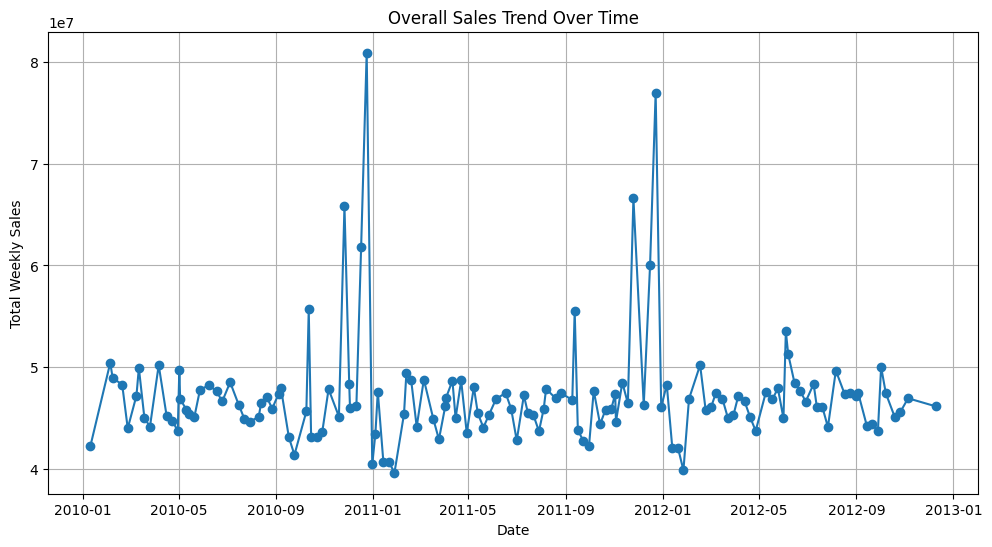

In [21]:
# Plotting chart - Overal Sales Trend Over Time
plt.figure(figsize=(12, 6))
plt.plot(pd.to_datetime(sales_trend['Date']), sales_trend['Weekly_Sales'], marker='o', linestyle='-')
plt.title('Overall Sales Trend Over Time')
plt.xlabel('Date')
plt.ylabel('Total Weekly Sales')
plt.grid()
plt.show()

## Sales During Holiday vs Non-Holiday Weeks

In [22]:
holiday_sales = df_retail_data.groupby('IsHoliday')['Weekly_Sales'].sum()

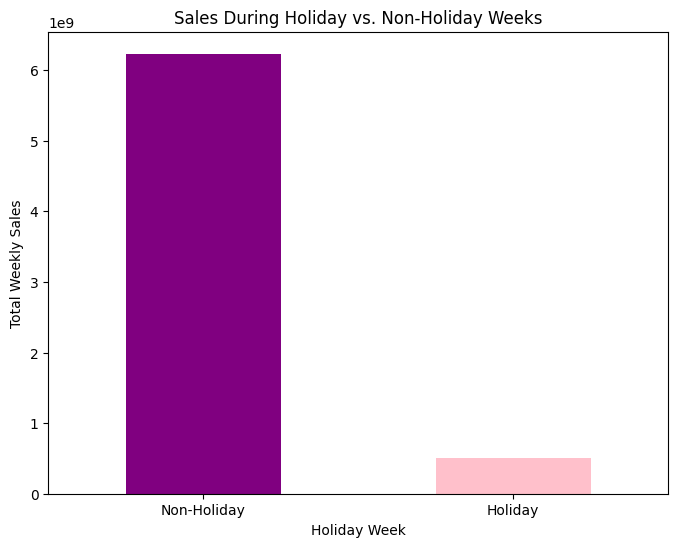

In [26]:
holiday_sales.plot(kind='bar', figsize=(8, 6), color=['purple', 'pink'])
plt.title('Sales During Holiday vs. Non-Holiday Weeks')
plt.xlabel('Holiday Week')
plt.ylabel('Total Weekly Sales')
plt.xticks(ticks=[0, 1], labels=['Non-Holiday', 'Holiday'], rotation=0)
plt.show()

## Sales Across Different Store Types

In [28]:
type_sales = df_retail_data.groupby('Type')['Weekly_Sales'].sum()

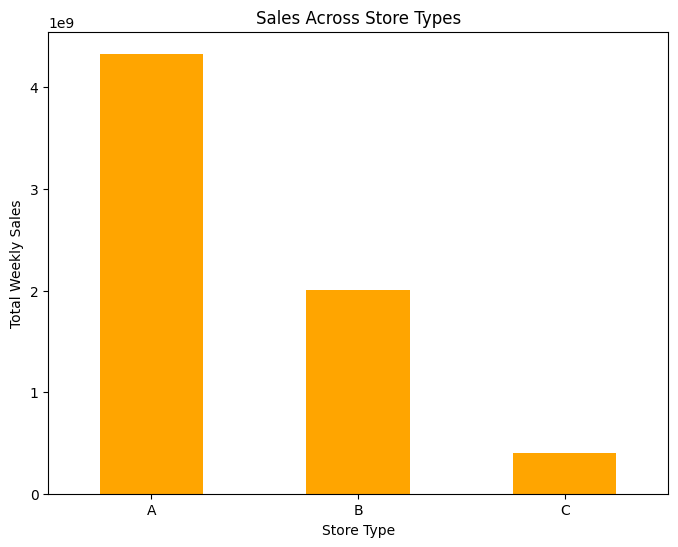

In [29]:
type_sales.plot(kind='bar', figsize=(8, 6), color='orange')
plt.title('Sales Across Store Types')
plt.xlabel('Store Type')
plt.ylabel('Total Weekly Sales')
plt.xticks(rotation=0)
plt.show()

## Departments with the Highest Weekly Sales

In [30]:
dept_sales = df_retail_data.groupby('Dept')['Weekly_Sales'].sum().sort_values(ascending=False)

In [31]:
top_depts = dept_sales.head(10)

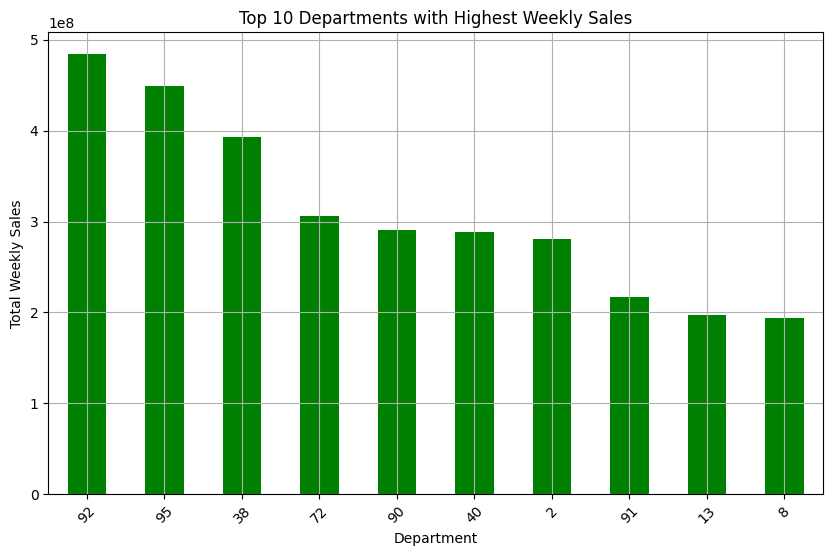

In [41]:
top_depts.plot(kind='bar', figsize=(10, 6), color='green')
plt.title('Top 10 Departments with Highest Weekly Sales')
plt.xlabel('Department')
plt.ylabel('Total Weekly Sales')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


## Effect of markdowns on sale price during holidays

In [42]:
print(df_retail_data.columns)

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4',
       'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Sales_Diff'],
      dtype='object')


In [45]:
holiday_promotion = df_retail_data[df_retail_data['IsHoliday']==True]
non_holiday_promotion = df_retail_data[df_retail_data['IsHoliday']==False]

In [47]:
fig = px.scatter(holiday_promotion, x='MarkDown1', y='Weekly_Sales',
                color='Store',
                title='Effect of markdowns on sales price during holidays')
fig.show()

fig = px.scatter(non_holiday_promotion, x='MarkDown1', y='Weekly_Sales',
                color='Store',
                title='Effect of markdowns on sales price during non-holidays')
fig.show()